# Atividade com o dataset



## Dataset De Detecção de Fraudes

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import Counter #para contagem de frequências
import plotly.express as px
from sklearn.ensemble import IsolationForest
from sklearn import linear_model
from sklearn.svm import OneClassSVM
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
import numpy as np
from sklearn import preprocessing
import tqdm
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering # hiarárquico
import tensorflow as tf
import random as rn
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.pipeline import Pipeline
from datetime import datetime


2023-07-14 08:37:59.139929: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:8893] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-07-14 08:37:59.140001: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-07-14 08:37:59.141664: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-07-14 08:37:59.338500: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-14 08:38:00.356209: W tensorflow/compiler/

Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.


In [2]:
print(torch.cuda.is_available())
print(torch.zeros(1).cuda())
print(torch.cuda.get_device_properties(0))

True
tensor([0.], device='cuda:0')
_CudaDeviceProperties(name='NVIDIA GeForce RTX 2060 SUPER', major=7, minor=5, total_memory=7797MB, multi_processor_count=34)


In [3]:
dataset = pd.read_csv("creditcard.csv")
dataset.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


Frequencias  [(0, 284315), (1, 492)]


<AxesSubplot: ylabel='Frequency'>

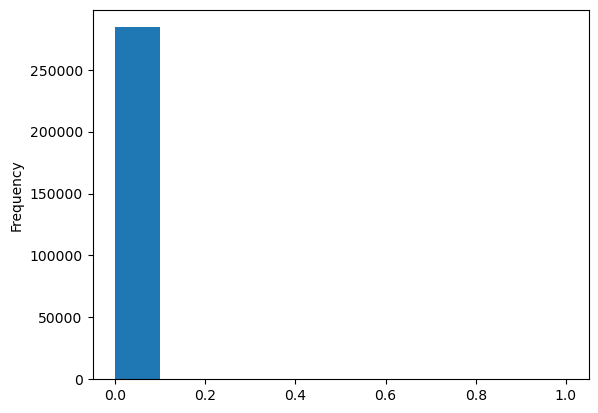

In [4]:
#Frequencia das classes com gráfico de barras
freq_class = sorted(Counter(dataset['Class']).items())
print('Frequencias ',freq_class)
dataset['Class'].plot.hist()

## Separando os dados de Treino e Teste
>Aqui diferentemente de AM Supervisionado, não precisamos de um conjunto de validação porque não vamos precisamos observar overfitting e o ajuste de parâmetro é feito no próprio conjunto de treino.

In [5]:
X = dataset.drop('Class', axis=1) #Atributos
y = dataset['Class'] #Rótulos
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) #80% Treino e 20% Teste

Training set:
Frequencias  [(0, 227451), (1, 394)]


<AxesSubplot: ylabel='Frequency'>

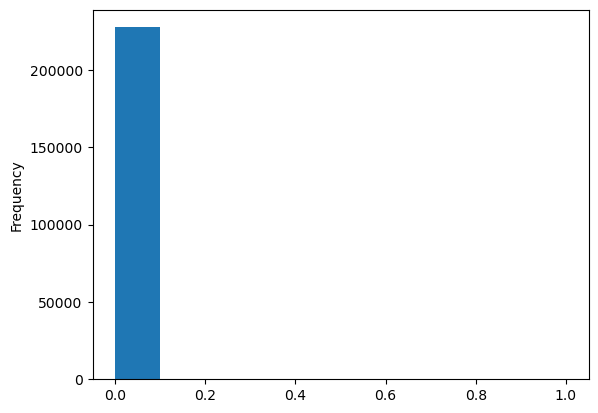

In [6]:
print('Training set:')
attributes = pd.DataFrame(X_train)
labels = pd.Series(y_train, name='class')
df_train = pd.concat([attributes, labels], axis=1)

#Frequencia das classes com gráfico de barras
freq_class = sorted(Counter(df_train['class']).items())
print('Frequencias ',freq_class)
df_train['class'].plot.hist()

Test set:
Frequencias  [(0, 56864), (1, 98)]


<AxesSubplot: ylabel='Frequency'>

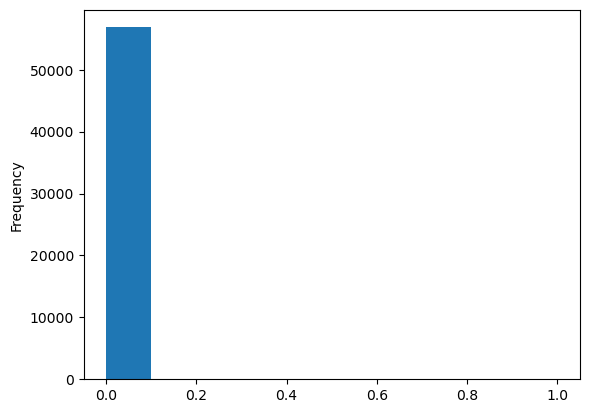

In [7]:
print('Test set:')
attributes = pd.DataFrame(X_test)
labels = pd.Series(y_test, name='class')
df_test = pd.concat([attributes, labels], axis=1)
#Frequencia das classes com gráfico de barras
freq_class = sorted(Counter(df_test['class']).items())
print('Frequencias ',freq_class)
df_test['class'].plot.hist()

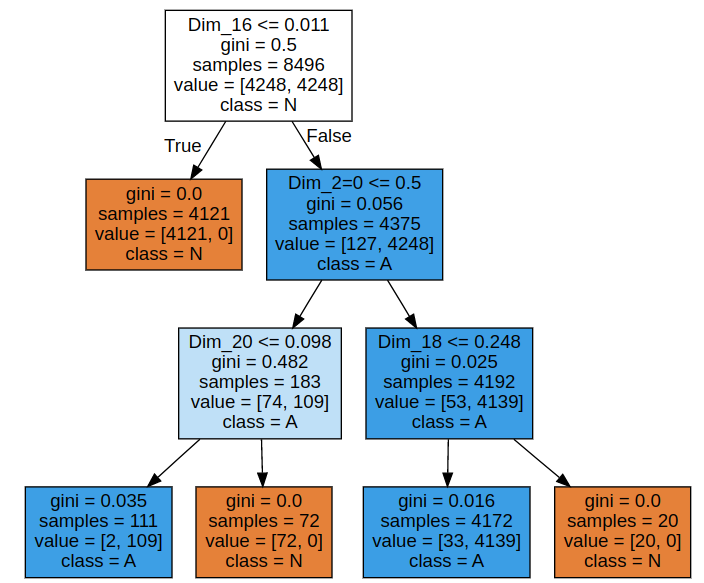

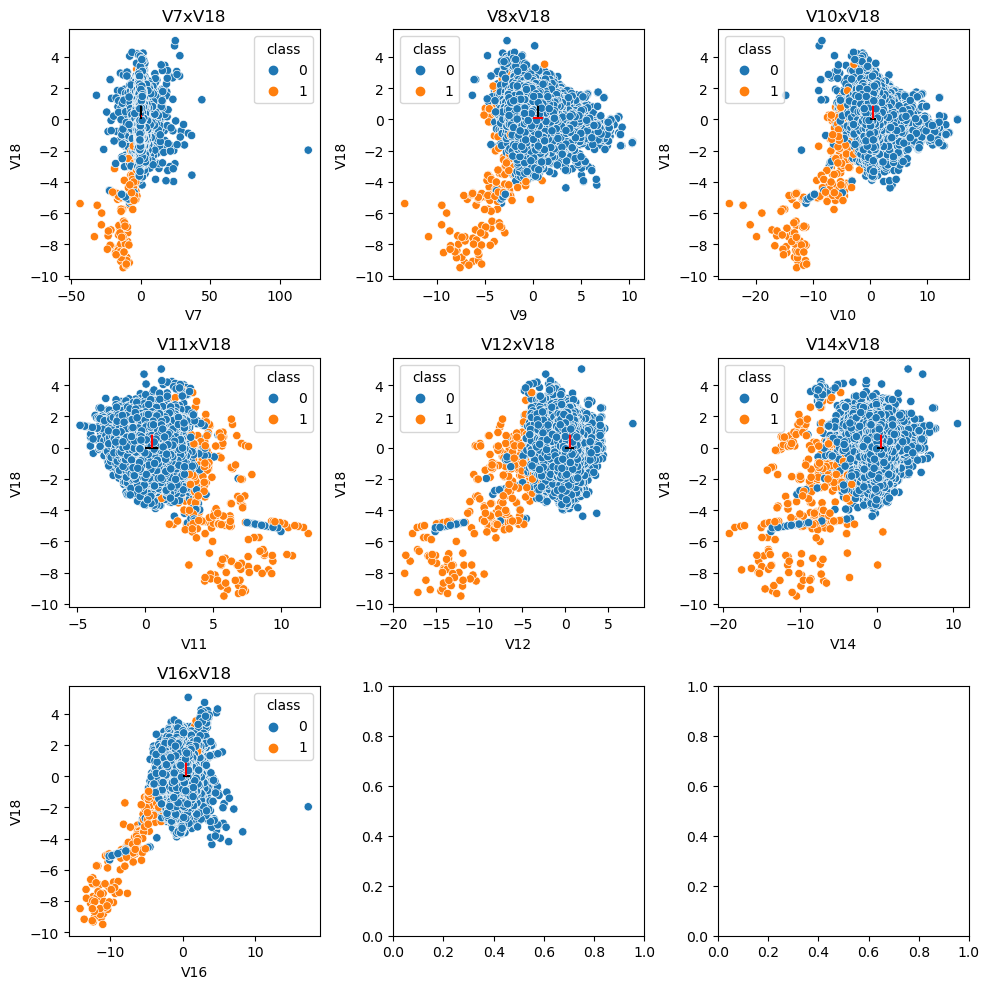

In [8]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(10, 10))
sns.scatterplot(x='V7', y='V18', hue='class', data=df_train,ax=axs[0,0])
sns.scatterplot(x='V9', y='V18', hue='class', data=df_train,ax=axs[0,1])
sns.scatterplot(x='V10', y='V18', hue='class', data=df_train,ax=axs[0,2])
sns.scatterplot(x='V11', y='V18', hue='class', data=df_train,ax=axs[1,0])
sns.scatterplot(x='V12', y='V18', hue='class', data=df_train,ax=axs[1,1])
sns.scatterplot(x='V14', y='V18', hue='class', data=df_train,ax=axs[1,2])
sns.scatterplot(x='V16', y='V18', hue='class', data=df_train,ax=axs[2,0])
axs[0,0].set_title('V7xV18')
axs[0,0].plot((0.5, 0.5),(0.0,1.0),'-.k')
axs[0,0].plot((0.0, 1.0),(0.248,0.248),'-.r')
axs[0,1].set_title('V8xV18')
axs[0,1].plot((0.5, 0.5),(0.0,1.0),'-.k')
axs[0,1].plot((0.0, 1.0),(0.098,0.098),'-.r')
axs[0,2].set_title('V10xV18')
axs[0,2].plot((0.0, 1.0),(0.011,0.011),'-.k')
axs[0,2].plot((0.5, 0.5),(0.011,1.0),'-.r')
axs[1,0].set_title('V11xV18')
axs[1,0].plot((0.0, 1.0),(0.011,0.011),'-.k')
axs[1,0].plot((0.5, 0.5),(0.011,1.0),'-.r')
axs[1,1].set_title('V12xV18')
axs[1,1].plot((0.0, 1.0),(0.011,0.011),'-.k')
axs[1,1].plot((0.5, 0.5),(0.011,1.0),'-.r')
axs[1,2].set_title('V14xV18')
axs[1,2].plot((0.0, 1.0),(0.011,0.011),'-.k')
axs[1,2].plot((0.5, 0.5),(0.011,1.0),'-.r')
axs[2,0].set_title('V16xV18')
axs[2,0].plot((0.0, 1.0),(0.011,0.011),'-.k')
axs[2,0].plot((0.5, 0.5),(0.011,1.0),'-.r')
plt.tight_layout()
plt.show()

## Isolation Forest

In [8]:

clf = IsolationForest(n_estimators=100, #Número de árvores
                      #contamination=auto, #Porcentagem de dados anomalos
                      max_samples=300, # Número máximos de amostrar para avaliar as regras
                      random_state=42,
                      warm_start=True,
                      verbose=1)

clf.fit(df_train.drop('class', axis=1))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s finished


IsolationForest(max_samples=300, random_state=42, verbose=1, warm_start=True)

In [9]:
df_train_copy = df_train.copy()
df_train_copy['out_scores'] = clf.decision_function(df_train.drop('class', axis=1))
df_train_copy['anomaly']=clf.predict(df_train.drop(['class'], axis=1))
df_train_copy[df_train_copy['class'] == 1].head(20)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V23,V24,V25,V26,V27,V28,Amount,class,out_scores,anomaly
276071,166883.0,2.091900,-0.757459,-1.192258,-0.755458,-0.620324,-0.322077,-1.082511,0.117200,-0.140927,...,0.142007,0.592615,-0.196143,-0.136676,0.020182,-0.015470,19.95,1,0.097179,1
44556,41991.0,-4.566342,3.353451,-4.572028,3.616119,-2.493138,-1.090000,-5.551433,0.447783,-2.424414,...,-0.302447,-0.086396,-0.516060,-0.295102,0.195985,0.141115,1.00,1,-0.110992,-1
251891,155548.0,1.878230,1.325630,-2.333469,4.233151,1.355184,-0.853508,0.716025,-0.164910,-1.502345,...,0.043414,-0.242380,0.171098,-0.002601,-0.026667,0.005238,7.06,1,0.043085,1
150677,93879.0,-13.086519,7.352148,-18.256576,10.648505,-11.731476,-3.659167,-14.873658,8.810473,-5.418204,...,-0.412861,0.519952,-0.743909,-0.167808,-2.498300,-0.711066,30.31,1,-0.214515,-1
149869,92092.0,-1.108478,3.448953,-6.216972,3.021052,-0.529901,-2.551375,-2.001743,1.092432,-0.836098,...,0.208559,-0.295497,-0.690232,-0.364749,0.229327,0.208830,18.00,1,-0.074334,-1
152019,96717.0,-3.705856,4.107873,-3.803656,1.710314,-3.582466,1.469729,-9.621560,-11.913105,-0.322297,...,0.916236,-0.255504,-0.183835,-0.584539,-0.315484,-0.097223,1.00,1,-0.135806,-1
252124,155662.0,-1.928613,4.601506,-7.124053,5.716088,1.026579,-3.189073,-2.261897,1.185096,-4.441942,...,-0.354639,-0.701492,-0.030973,0.034070,0.573393,0.294686,0.77,1,-0.095864,-1
221041,142409.0,-1.172183,1.661713,-3.049637,2.555058,3.669035,-3.162998,-5.985640,-2.179935,-1.120292,...,-5.988806,0.714381,-1.600024,-0.634783,0.822713,0.494375,2.00,1,-0.084755,-1
239499,150138.0,-2.150855,2.187917,-3.430516,0.119476,-0.173210,0.290700,-2.808988,-2.679351,-0.556685,...,-0.075034,-0.437619,0.353841,-0.521339,0.144465,0.026588,50.00,1,-0.026735,-1
43160,41397.0,-14.970346,8.401421,-16.867238,8.252334,-13.565130,-2.782438,-14.263735,9.643419,-7.701499,...,-0.439666,0.519514,0.789328,0.064357,-1.621386,-1.104819,273.01,1,-0.214011,-1


In [10]:
freq_class = sorted(Counter(df_train['class']).items())
print('Frequencias ',freq_class)
qtd_outliers = len(df_train_copy[df_train_copy['anomaly'] == -1])
print('QTD-Outliers',qtd_outliers)
df_train_copy[df_train_copy['anomaly'] == -1].head(20)

Frequencias  [(0, 227451), (1, 394)]
QTD-Outliers 9191


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V23,V24,V25,V26,V27,V28,Amount,class,out_scores,anomaly
66915,52275.0,-3.813513,-4.717356,0.506226,0.088980,2.428613,-2.786441,-2.704680,0.501975,-3.448436,...,-0.371977,0.049780,0.415635,0.156697,0.047246,-0.751996,15.00,0,-0.032024,-1
138848,82881.0,-0.888461,-4.589302,0.302576,-0.863708,-2.735330,1.394933,-0.365221,0.489701,3.523169,...,-1.048228,-0.170969,0.148241,-0.556648,-0.012403,0.192278,1016.76,0,-0.033942,-1
132984,80200.0,-2.198666,3.995769,-3.284767,1.130628,-0.179446,-2.336796,0.413867,0.322868,1.904305,...,0.351230,0.282254,0.102362,-0.361464,1.377055,0.680469,0.89,0,-0.002534,-1
137730,82299.0,-10.351027,8.236383,-8.625391,0.757760,-5.859485,-1.885789,-5.783859,7.822725,-0.839146,...,1.030784,-0.483499,0.488172,-0.299879,-0.752224,-0.320440,14.23,0,-0.109482,-1
163378,115885.0,-3.820706,3.287639,-0.906160,0.649751,2.461104,6.515232,-3.556839,-8.195556,0.001001,...,1.139287,0.506831,-0.534908,-0.186318,0.240123,0.346615,3.52,0,-0.097876,-1
94368,64850.0,-1.619880,1.708016,-0.616540,-0.540667,1.555109,5.220242,-2.677505,-5.311598,0.446991,...,0.378552,0.965899,1.752563,0.749010,0.308396,0.191559,6.99,0,-0.021637,-1
265708,162013.0,-2.609145,-4.121300,0.143253,1.859216,4.762229,0.096023,-3.871022,0.905895,0.843369,...,-0.202908,-0.845558,-2.951458,0.788758,1.005488,0.130295,11.50,0,-0.033147,-1
198113,132337.0,-3.203015,-1.397079,-1.034210,-3.816240,3.780556,-1.391327,0.934977,-0.369243,1.245951,...,-1.231428,-1.502421,1.851000,-0.350655,-0.288984,0.675569,18.18,0,-0.015085,-1
44600,42014.0,-5.207653,3.865472,-0.398679,-1.805924,-2.737965,3.806235,-7.497877,-19.086977,-0.754345,...,0.428926,0.293642,-0.164805,-0.930976,-0.192808,0.226669,257.30,0,-0.103922,-1
116369,74246.0,-3.579188,3.390245,-2.689544,1.780568,1.201481,4.748220,-2.476536,-2.759442,-1.084765,...,0.947338,0.784962,-0.193878,-0.040666,-0.779969,0.132123,45.37,0,-0.044091,-1


In [11]:
df_train_copy[df_train_copy['class'] == 1]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V23,V24,V25,V26,V27,V28,Amount,class,out_scores,anomaly
276071,166883.0,2.091900,-0.757459,-1.192258,-0.755458,-0.620324,-0.322077,-1.082511,0.117200,-0.140927,...,0.142007,0.592615,-0.196143,-0.136676,0.020182,-0.015470,19.95,1,0.097179,1
44556,41991.0,-4.566342,3.353451,-4.572028,3.616119,-2.493138,-1.090000,-5.551433,0.447783,-2.424414,...,-0.302447,-0.086396,-0.516060,-0.295102,0.195985,0.141115,1.00,1,-0.110992,-1
251891,155548.0,1.878230,1.325630,-2.333469,4.233151,1.355184,-0.853508,0.716025,-0.164910,-1.502345,...,0.043414,-0.242380,0.171098,-0.002601,-0.026667,0.005238,7.06,1,0.043085,1
150677,93879.0,-13.086519,7.352148,-18.256576,10.648505,-11.731476,-3.659167,-14.873658,8.810473,-5.418204,...,-0.412861,0.519952,-0.743909,-0.167808,-2.498300,-0.711066,30.31,1,-0.214515,-1
149869,92092.0,-1.108478,3.448953,-6.216972,3.021052,-0.529901,-2.551375,-2.001743,1.092432,-0.836098,...,0.208559,-0.295497,-0.690232,-0.364749,0.229327,0.208830,18.00,1,-0.074334,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42674,41194.0,-7.896886,5.381020,-8.451162,7.963928,-7.862419,-2.376820,-11.949723,5.051356,-6.912076,...,0.032795,0.638073,0.361887,0.444577,1.101923,0.205958,1.52,1,-0.186146,-1
33276,37167.0,-7.923891,-5.198360,-3.000024,4.420666,2.272194,-3.394483,-5.283435,0.131619,0.658176,...,-4.908301,0.410170,-1.167660,0.520508,1.937421,-1.552593,12.31,1,-0.158290,-1
182992,125612.0,1.889618,1.073099,-1.678018,4.173268,1.015516,-0.009389,-0.079706,0.064071,-0.714517,...,-0.036560,0.334306,0.147171,0.279556,0.031669,0.035883,3.22,1,0.043004,1
154697,102625.0,-4.221221,2.871121,-5.888716,6.890952,-3.404894,-1.154394,-7.739928,2.851363,-2.507569,...,-0.578007,-0.059045,-1.829169,-0.072429,0.136734,-0.599848,7.59,1,-0.175902,-1


In [12]:
freq_class[0][1]

227451

In [13]:
#precisamos separar anomalias da classe zero e da classe um para calcular a acuracia
#print("Accuracy percentage:", 100*list(df_train_copy['anomaly']).count(-1)/(freq_class[1][1]))
df1 = df_train_copy[df_train_copy['class'] == 1]
print("Accuracy percentage (fraude):", 100*list(df1['anomaly']).count(-1)/(freq_class[1][1]))
df0 = df_train_copy[df_train_copy['class'] == 0]
print("Accuracy percentage (naofraude):", (100*(1-list(df0['anomaly']).count(-1)/(freq_class[0][1]))))



Accuracy percentage (fraude): 83.75634517766497
Accuracy percentage (naofraude): 96.10421585308484


In [14]:
#nao deu certo esse codigo, por isso o anteriorr
#print("Accuracy percentage:", 100*list(df_train_copy['anomaly']).count(-1)/(freq_class[1][1]))

## ONE-CLASS SVM

In [15]:
clf = linear_model.SGDOneClassSVM(nu=0.1, #porcentagem de exemplos com anomalias
                  eta0=0.001) #Learning rate inicial
clf.fit(df_train.drop('class', axis=1))

SGDOneClassSVM(eta0=0.001, nu=0.1)

In [16]:
df_train_copy = df_train.copy()
df_train_copy['out_scores'] = clf.score_samples(df_train.drop('class', axis=1))
df_train_copy['anomaly']=clf.predict(df_train.drop(['class'], axis=1))
df_train_copy[df_train_copy['class'] == 1].head(20)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V23,V24,V25,V26,V27,V28,Amount,class,out_scores,anomaly
276071,166883.0,2.091900,-0.757459,-1.192258,-0.755458,-0.620324,-0.322077,-1.082511,0.117200,-0.140927,...,0.142007,0.592615,-0.196143,-0.136676,0.020182,-0.015470,19.95,1,203315.721247,1
44556,41991.0,-4.566342,3.353451,-4.572028,3.616119,-2.493138,-1.090000,-5.551433,0.447783,-2.424414,...,-0.302447,-0.086396,-0.516060,-0.295102,0.195985,0.141115,1.00,1,51157.947607,1
251891,155548.0,1.878230,1.325630,-2.333469,4.233151,1.355184,-0.853508,0.716025,-0.164910,-1.502345,...,0.043414,-0.242380,0.171098,-0.002601,-0.026667,0.005238,7.06,1,189505.479488,1
150677,93879.0,-13.086519,7.352148,-18.256576,10.648505,-11.731476,-3.659167,-14.873658,8.810473,-5.418204,...,-0.412861,0.519952,-0.743909,-0.167808,-2.498300,-0.711066,30.31,1,114375.090868,1
149869,92092.0,-1.108478,3.448953,-6.216972,3.021052,-0.529901,-2.551375,-2.001743,1.092432,-0.836098,...,0.208559,-0.295497,-0.690232,-0.364749,0.229327,0.208830,18.00,1,112197.275779,1
152019,96717.0,-3.705856,4.107873,-3.803656,1.710314,-3.582466,1.469729,-9.621560,-11.913105,-0.322297,...,0.916236,-0.255504,-0.183835,-0.584539,-0.315484,-0.097223,1.00,1,117830.965684,1
252124,155662.0,-1.928613,4.601506,-7.124053,5.716088,1.026579,-3.189073,-2.261897,1.185096,-4.441942,...,-0.354639,-0.701492,-0.030973,0.034070,0.573393,0.294686,0.77,1,189644.003671,1
221041,142409.0,-1.172183,1.661713,-3.049637,2.555058,3.669035,-3.162998,-5.985640,-2.179935,-1.120292,...,-5.988806,0.714381,-1.600024,-0.634783,0.822713,0.494375,2.00,1,173497.862239,1
239499,150138.0,-2.150855,2.187917,-3.430516,0.119476,-0.173210,0.290700,-2.808988,-2.679351,-0.556685,...,-0.075034,-0.437619,0.353841,-0.521339,0.144465,0.026588,50.00,1,182916.917302,1
43160,41397.0,-14.970346,8.401421,-16.867238,8.252334,-13.565130,-2.782438,-14.263735,9.643419,-7.701499,...,-0.439666,0.519514,0.789328,0.064357,-1.621386,-1.104819,273.01,1,50449.935009,1


In [17]:
freq_class = sorted(Counter(df_train['class']).items())
print('Frequencias ',freq_class)
qtd_outliers = len(df_train_copy[df_train_copy['anomaly'] == -1])
print('QTD-Outliers',qtd_outliers)
df_train_copy[df_train_copy['anomaly'] == -1].head(20)

Frequencias  [(0, 227451), (1, 394)]
QTD-Outliers 14


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V23,V24,V25,V26,V27,V28,Amount,class,out_scores,anomaly
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0,6.470234,-1
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0,0.155803,-1
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0,8.335842,-1
14,12.0,-2.791855,-0.327771,1.641750,1.767473,-0.136588,0.807596,-0.422911,-1.907107,0.755713,...,1.020586,0.028317,-0.232746,-0.235557,-0.164778,-0.030154,58.80,0,18.009804,-1
8,7.0,-0.894286,0.286157,-0.113192,-0.271526,2.669599,3.721818,0.370145,0.851084,-0.392048,...,-0.204233,1.011592,0.373205,-0.384157,0.011747,0.142404,93.20,0,13.897299,-1
17,13.0,-0.436905,0.918966,0.924591,-0.727219,0.915679,-0.127867,0.707642,0.087962,-0.665271,...,-0.156858,-0.888386,-0.342413,-0.049027,0.079692,0.131024,0.89,0,15.890736,-1
7,7.0,-0.644269,1.417964,1.074380,-0.492199,0.948934,0.428118,1.120631,-3.807864,0.615375,...,0.057504,-0.649709,-0.415267,-0.051634,-1.206921,-1.085339,40.80,0,10.881383,-1
13,11.0,1.069374,0.287722,0.828613,2.712520,-0.178398,0.337544,-0.096717,0.115982,-0.221083,...,-0.071407,0.104744,0.548265,0.104094,0.021491,0.021293,27.50,0,14.985651,-1
19,15.0,1.492936,-1.029346,0.454795,-1.438026,-1.555434,-0.720961,-1.080664,-0.053127,-1.978682,...,0.040002,0.295814,0.332931,-0.220385,0.022298,0.007602,5.00,0,18.563237,-1
9,9.0,-0.338262,1.119593,1.044367,-0.222187,0.499361,-0.246761,0.651583,0.069539,-0.736727,...,-0.120794,-0.385050,-0.069733,0.094199,0.246219,0.083076,3.68,0,11.178847,-1


## Auto Encoders

In [18]:

# Definindo a arquitetura do Auto Enconder
class Autoencoder(nn.Module):
    def __init__(self, input_dim, encoding_dim):
        super(Autoencoder, self).__init__()
        ## encoder ##
        # linear layer (input_dim -> encoding_dim)
        self.fc1 = nn.Linear(input_dim, encoding_dim)

        ## decoder ##
        # linear layer (encoding_dim -> input_dim)
        self.fc2 = nn.Linear(encoding_dim, input_dim)


    def forward(self, x):
        # add layer, with relu activation function
        x = F.relu(self.fc1(x))
        # output layer (sigmoid for scaling from 0 to 1)
        x = F.sigmoid(self.fc2(x))
        return x

# initialize the NN
number_att = X_train.shape[1] #Quantidade de Atributos (sem a classe)
encoding_dim = 8
model = Autoencoder(number_att, encoding_dim)
print(model)

Autoencoder(
  (fc1): Linear(in_features=30, out_features=8, bias=True)
  (fc2): Linear(in_features=8, out_features=30, bias=True)
)


In [19]:
learning_rate = 1e-3
#loss_fn=nn.MSELoss(reduction='none')
loss_fn=nn.MSELoss()
optimizer=torch.optim.Adam(model.parameters(), lr=learning_rate, capturable=True, amsgrad=True, foreach=True)
#optimizer.param_groups[0]['capturable'] = True

In [20]:


#Criando a estrutura de dados para o PYTORCH (Variable -> Tensor)
X_trainT = Variable(torch.from_numpy(X_train.to_numpy())).float()
y_trainT = Variable(torch.from_numpy(y_train.to_numpy())).long()

X_testT  = Variable(torch.from_numpy(X_test.to_numpy())).float()
y_testT  = Variable(torch.from_numpy(y_test.to_numpy())).long()

In [21]:
device = device='cuda:0'
X_trainT = X_trainT.to(device)
y_trainT = y_trainT.to(device)

X_testT  = X_testT.to(device)
y_testT = y_testT.to(device)
model = model.to(device)

X_trainT.is_cuda

True

In [22]:
#Treinamento do Modelo

EPOCHS  = 1000
min_loss = 100000
best_epoch = -1
#max_accuracy = 0
#ac_best_epoch = -1

loss_train   = np.zeros((EPOCHS,))
loss_val     = np.zeros((EPOCHS,))
accuracy_list = np.zeros((EPOCHS,))
#device = device

for epoch in tqdm.trange(EPOCHS):

    y_pred = model(X_trainT)
    loss = loss_fn(y_pred, X_trainT)
    loss_train[epoch] = loss.item()
    optimizer.zero_grad() # Zerando os valores de Gradiente para não serem considerados da época anterior
    loss.backward() # Calculando o Gradiente
    optimizer.step() #Atualizando os paramentros da rede

    with torch.no_grad(): #Aplicando o conjunto de validação
        y_pred = model(X_trainT)
        loss = loss_fn(y_pred, X_trainT)
        loss_val[epoch] = loss.item()
        if loss_val[epoch] < min_loss:
          best_epoch = epoch
          min_loss = loss_val[epoch]
        correct = (torch.argmax(y_pred, dim=1) == y_trainT).type(torch.FloatTensor)
        accuracy_list[epoch] = correct.mean()
#        if correct.mean()>max_accuracy:
#          ac_best_epoch = epoch
#          max_accuracy = correct.mean()

#print('\nMenor erro da Validação: ',min_loss,' EPOCA ',best_epoch)
#print('\nmelhor acurácia: ',max_accuracy,' EPOCA ',ac_best_epoch)

100%|██████████| 1000/1000 [00:08<00:00, 123.50it/s]


In [23]:

print('\nMenor erro da Validação: ',min_loss,' EPOCA ',best_epoch)
#print('\nmelhor acurácia: ',max_accuracy,' EPOCA ',ac_best_epoch)


Menor erro da Validação:  100000  EPOCA  -1


In [24]:

print(pd.DataFrame(accuracy_list).head())
print(pd.DataFrame(accuracy_list).tail())

          0
0  0.996941
1  0.996945
2  0.996958
3  0.996958
4  0.996958
            0
995  0.998266
996  0.998266
997  0.998266
998  0.998266
999  0.998266


In [25]:

print(pd.DataFrame(loss_val).head())
print(pd.DataFrame(loss_val).tail())

             0
0  374688512.0
1  374688512.0
2  374688512.0
3  374688512.0
4  374688512.0
               0
995  374688512.0
996  374688512.0
997  374688512.0
998  374688512.0
999  374688512.0


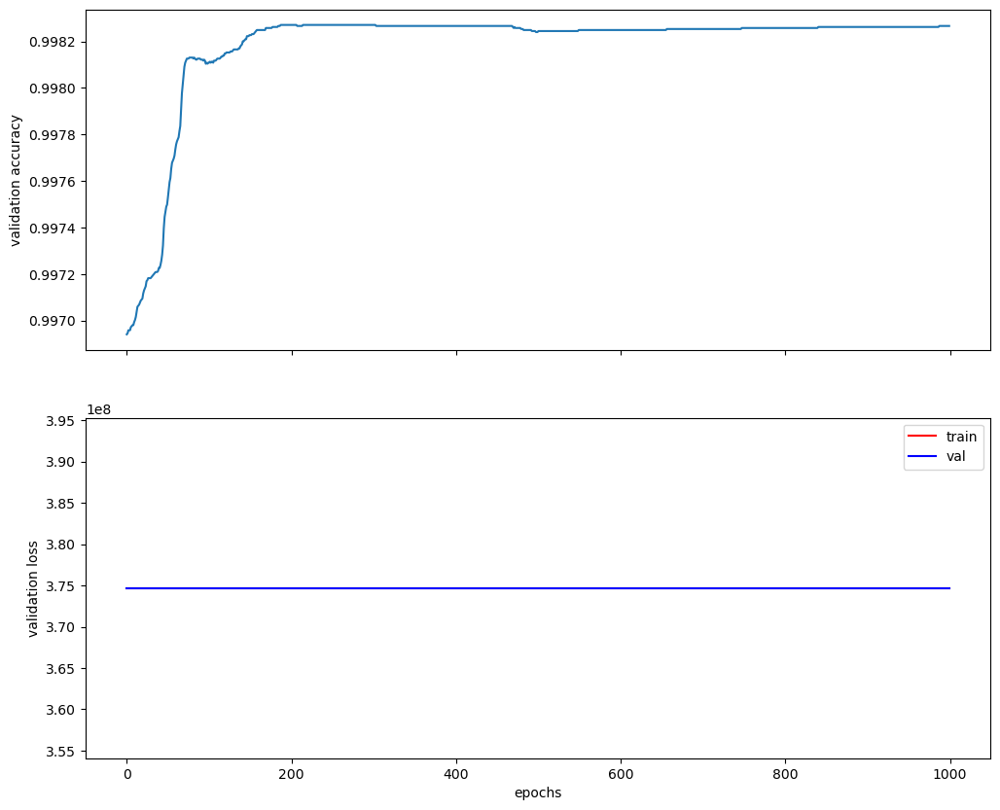

In [26]:
fig, (ax1, ax2) = plt.subplots(2, figsize=(12, 10), sharex=True)

ax1.plot(accuracy_list)
ax1.set_ylabel("validation accuracy")
ax2.plot(loss_train,'-r',label='train')
ax2.plot(loss_val,'-b',label='val')
ax2.set_ylabel("validation loss")
ax2.set_xlabel("epochs")
ax2.legend()

In [28]:
new_DATA = model.cpu().fc1(X_trainT.cpu()).detach().numpy()
attributes = pd.DataFrame(new_DATA,columns = ['A1','A2','A3','A4','A5','A6','A7','A8'])
labels = pd.Series(y_train.to_numpy(), name='class')
df_train2 = pd.concat([attributes, labels], axis=1)

print(df_train2)

                  A1            A2           A3            A4           A5  \
0      -15359.223633  27988.710938 -2024.820190  11366.969727  6592.916992   
1      -12560.075195  22879.714844 -1642.845337   9299.853516  5393.886719   
2      -16025.866211  29202.833984 -2108.809814  11860.255859  6879.598145   
3      -10055.162109  18296.923828 -1270.888184   7450.472656  4315.606445   
4       -8859.925781  16141.710938 -1157.406738   6557.363770  3801.839844   
...              ...           ...          ...           ...          ...   
227840  -8102.177246  14763.983398 -1068.084229   5996.167969  3476.927246   
227841 -17047.878906  31045.607422 -2206.728516  12625.508789  7321.372559   
227842  -8549.804688  15580.549805 -1129.930298   6328.086426  3670.161133   
227843  -9419.985352  17166.738281 -1241.734497   6971.907227  4046.360840   
227844  -8201.070312  14918.298828 -1029.913452   6079.759277  3521.903809   

                 A6            A7           A8  class  
0      

In [29]:
print(df_train2[df_train2['class']==1])

                  A1            A2           A3            A4           A5  \
427    -17881.970703  32583.978516 -2350.806641  13234.455078  7674.804199   
838     -4498.161621   8199.809570  -590.947449   3330.808594  1931.912109   
1174   -16666.164062  30372.544922 -2193.827637  12331.389648  7150.976562   
1433   -10061.470703  18329.765625 -1297.424561   7446.651855  4321.107910   
1477    -9868.491211  17981.845703 -1293.251221   7303.080078  4236.584473   
...              ...           ...          ...           ...          ...   
223129  -4412.232910   8043.232910  -577.144409   3270.675293  1895.921265   
224586  -3985.890381   7260.303223  -519.146118   2946.813232  1710.675293   
226816 -13457.752930  24526.716797 -1775.009033   9958.205078  5774.496094   
227348 -10995.382812  20039.326172 -1445.493042   8136.515625  4719.056152   
227650 -15620.076172  28309.001953 -1732.074585  11616.326172  6711.490234   

                 A6            A7           A8  class  
427    

In [30]:
import plotly.express as px
fig = px.scatter_matrix(df_train2,
    dimensions=["A1", "A2", "A3", "A4", "A5", "A6", "A7", "A8"],
    color="class")
fig.show()

In [31]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [32]:
df_train2

,A1,A2,A3,A4,A5,A6,A7,A8,class
0,-15359.223633,27988.710938,-2024.820190,11366.969727,6592.916992,4900.120605,-14915.409180,8220.324219,0
1,-12560.075195,22879.714844,-1642.845337,9299.853516,5393.886719,4005.088623,-12197.971680,6722.269043,0
2,-16025.866211,29202.833984,-2108.809814,11860.255859,6879.598145,5110.648926,-15563.208008,8575.916016,0
3,-10055.162109,18296.923828,-1270.888184,7450.472656,4315.606445,3192.927979,-9762.642578,5382.451660,0
4,-8859.925781,16141.710938,-1157.406738,6557.363770,3801.839844,2825.240479,-8603.244141,4738.853027,0
...,...,...,...,...,...,...,...,...,...
227840,-8102.177246,14763.983398,-1068.084229,5996.167969,3476.927246,2586.806152,-7867.755371,4335.774902,0
227841,-17047.878906,31045.607422,-2206.728516,12625.508789,7321.372559,5427.491699,-16556.205078,9126.796875,0
227842,-8549.804688,15580.549805,-1129.930298,6328.086426,3670.161133,2729.393799,-8302.792969,4574.942383,0
227843,-9419.985352,17166.738281,-1241.734497,6971.907227,4046.360840,3004.738525,-9149.779297,5041.907227,0


In [33]:
X_clust = df_train2

In [34]:
clustering = AgglomerativeClustering(compute_distances=True).fit(X_clust.sample(50000))

In [35]:
clustering.labels_

array([1, 1, 1, ..., 0, 0, 1])

In [36]:
clustering.get_params(deep=True)

{'affinity': 'deprecated',
 'compute_distances': True,
 'compute_full_tree': 'auto',
 'connectivity': None,
 'distance_threshold': None,
 'linkage': 'ward',
 'memory': None,
 'metric': None,
 'n_clusters': 2}

In [37]:
clustering.children_.shape

(49999, 2)

In [38]:
childArray = clustering.children_

In [39]:
clustering.distances_

array([      0.        ,       0.        ,       0.        , ...,
        832980.31387424, 1161953.13437435, 3679480.38520851])

In [40]:
print(int(1+(2*len(childArray)/4)))

25000


In [41]:
for x in childArray:
  if ((x[0] <= len(childArray))and(x[1] >= (len(childArray) + int(1+(2*len(childArray)/4))-1))):
    print('outlier -> ',x)

outlier ->  [49244 75346]
outlier ->  [37921 75272]
outlier ->  [18913 75506]
outlier ->  [ 9420 75994]
outlier ->  [44353 76738]
outlier ->  [11299 75060]
outlier ->  [ 7221 76631]
outlier ->  [17439 75574]
outlier ->  [ 8147 75407]
outlier ->  [32640 75555]
outlier ->  [32235 76279]
outlier ->  [40694 75020]
outlier ->  [35731 75472]
outlier ->  [37038 76277]
outlier ->  [32805 75167]
outlier ->  [12737 76801]
outlier ->  [20123 76256]
outlier ->  [43757 75360]
outlier ->  [ 2373 75814]
outlier ->  [31049 75581]
outlier ->  [36272 76023]
outlier ->  [49729 76937]
outlier ->  [14405 76817]
outlier ->  [33017 75719]
outlier ->  [ 9447 75191]
outlier ->  [31799 76050]
outlier ->  [33582 75299]
outlier ->  [18419 77862]
outlier ->  [14077 75079]
outlier ->  [48274 75491]
outlier ->  [25675 75496]
outlier ->  [46920 76829]
outlier ->  [ 7384 77675]
outlier ->  [36621 76292]
outlier ->  [14798 76904]
outlier ->  [21344 75729]
outlier ->  [36224 75110]
outlier ->  [13362 77450]
outlier ->  

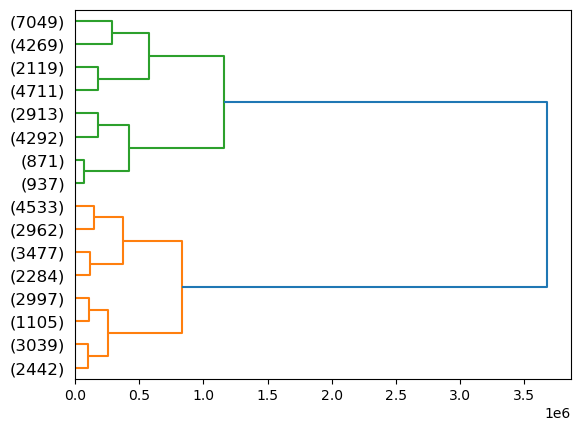

In [42]:
plot_dendrogram(clustering, truncate_mode="level", p=3,orientation='right')

In [43]:

normalized_df=(df_train2-df_train2.mean())/df_train2.std()
normalized_df['class'] = df_train2['class']
normalized_df.head()
#normaliza tudo
ncrop_df=df_train2
for i in ncrop_df.columns.drop('class'):
  ncrop_df[i] = (df_train2[i]-df_train2[i].min())/(df_train2[i].max()-df_train2[i].min())

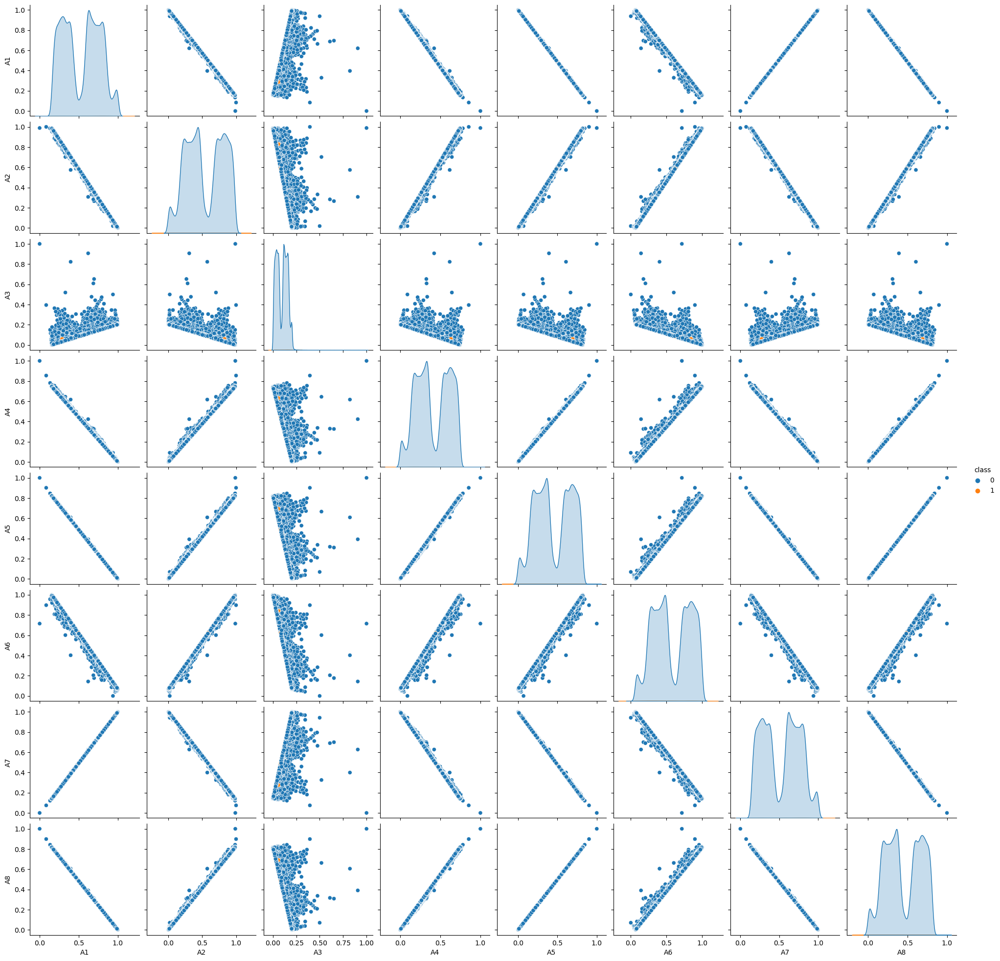

In [44]:
sns.pairplot(ncrop_df, hue='class')

<AxesSubplot: >

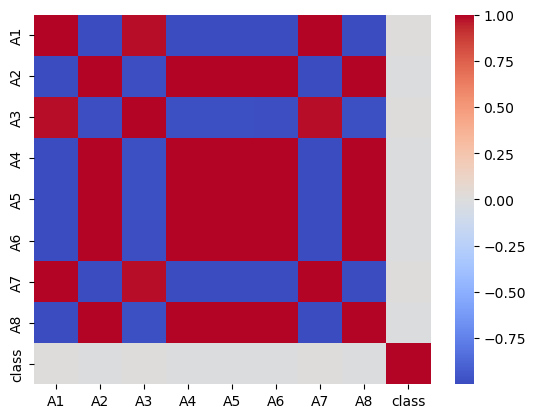

In [45]:

corr_matrix = df_train2.corr()
sns.heatmap(corr_matrix, annot=False, cmap='coolwarm')

os termos são muito correlatos, tem algo errado aqui.

In [46]:
from sklearn.cluster import KMeans
from sklearn.impute import SimpleImputer

In [47]:

model = KMeans(n_clusters=2)
model.fit(X_clust)
pred = model.labels_

/usr/lib/python3/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



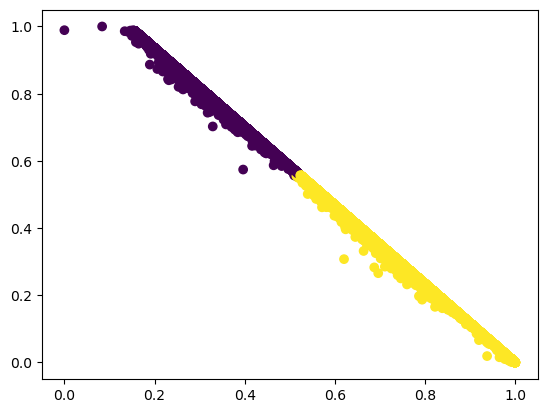

In [48]:
plt.scatter(X_clust.iloc[:,0],X_clust.iloc[:,1],c=model.labels_)

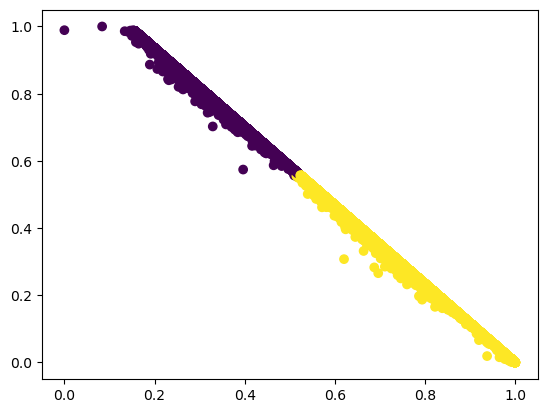

In [49]:
plt.scatter(X_clust.iloc[:,0],X_clust.iloc[:,1],c=model.labels_)

# https://www.kaggle.com/code/robinteuwens/anomaly-detection-with-auto-encoders/notebook#Latent-Space

In [3]:
tf.config.list_physical_devices('GPU')

2023-07-13 19:37:34.609294: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-07-13 19:37:34.631150: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-07-13 19:37:34.636202: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [6]:

df = pd.read_csv('creditcard.csv')
RANDOM_SEED = 42
TRAINING_SAMPLE = 200000
VALIDATE_SIZE = 0.2
np.random.seed(RANDOM_SEED)
rn.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

In [7]:
# let's quickly convert the columns to lower case and rename the Class column 
# so as to not cause syntax errors
df.columns = map(str.lower, df.columns)
df.rename(columns={'class': 'label'}, inplace=True)

# print first 5 rows to get an initial impression of the data we're dealing with
df.head()

,time,v1,v2,v3,v4,v5,v6,v7,v8,v9,...,v21,v22,v23,v24,v25,v26,v27,v28,amount,label
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
#Turn the amount feature into a normally distributed log equivalent. add a negligible amount to avoid taking the log of 0
df['log10_amount'] = np.log10(df.amount + 0.00001)

In [ ]:
# keep the label field at the back
df = df[
    [col for col in df if col not in ['label', 'log10_amount']] + 
    ['log10_amount', 'label']
]

In [8]:
# manual parameter 
RATIO_TO_FRAUD = 15

# dropping redundant columns
df = df.drop(['time', 'amount'], axis=1)

# splitting by class
fraud = df[df.label == 1]
clean = df[df.label == 0]

# undersample clean transactions
clean_undersampled = clean.sample(
    int(len(fraud) * RATIO_TO_FRAUD),
    random_state=RANDOM_SEED
)

# concatenate with fraud transactions into a single dataframe
visualisation_initial = pd.concat([fraud, clean_undersampled])
column_names = list(visualisation_initial.drop('label', axis=1).columns)

# isolate features from labels 
features, labels = visualisation_initial.drop('label', axis=1).values, \
                   visualisation_initial.label.values

In [9]:
print(f"""The non-fraud dataset has been undersampled from {len(clean):,} to {len(clean_undersampled):,}.
This represents a ratio of {RATIO_TO_FRAUD}:1 to fraud.""")

The non-fraud dataset has been undersampled from 284,315 to 7,380.
This represents a ratio of 15:1 to fraud.


In [10]:
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D

def tsne_scatter(features, labels, dimensions=2, save_as='graph.png'):
    if dimensions not in (2, 3):
        raise ValueError('tsne_scatter can only plot in 2d or 3d (What are you? An alien that can visualise >3d?). Make sure the "dimensions" argument is in (2, 3)')

    # t-SNE dimensionality reduction
    features_embedded = TSNE(n_components=dimensions, random_state=RANDOM_SEED).fit_transform(features)
    
    # initialising the plot
    fig, ax = plt.subplots(figsize=(8,8))
    
    # counting dimensions
    if dimensions == 3: ax = fig.add_subplot(111, projection='3d')

    # plotting data
    ax.scatter(
        *zip(*features_embedded[np.where(labels==1)]),
        marker='o',
        color='r',
        s=2,
        alpha=0.7,
        label='Fraud'
    )
    ax.scatter(
        *zip(*features_embedded[np.where(labels==0)]),
        marker='o',
        color='g',
        s=2,
        alpha=0.3,
        label='Clean'
    )

    # storing it to be displayed later
    plt.legend(loc='best')
    plt.savefig(save_as)
    plt.show

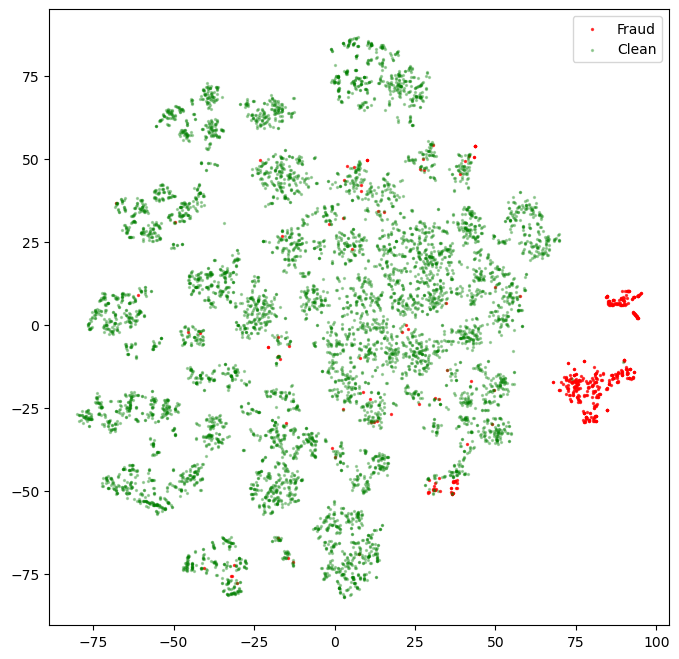

In [11]:
tsne_scatter(features, labels, dimensions=2, save_as='tsne_initial_2d.png')

In [12]:
print(f"""Shape of the datasets:
    clean (rows, cols) = {clean.shape}
    fraud (rows, cols) = {fraud.shape}""")

Shape of the datasets:
    clean (rows, cols) = (284315, 29)
    fraud (rows, cols) = (492, 29)


In [13]:
# shuffle our training set
clean = clean.sample(frac=1).reset_index(drop=True)

# training set: exlusively non-fraud transactions
X_train = clean.iloc[:TRAINING_SAMPLE].drop('label', axis=1)

# testing  set: the remaining non-fraud + all the fraud 
X_test = clean.iloc[TRAINING_SAMPLE:].append(fraud).sample(frac=1)

/tmp/ipykernel_1506787/3258428382.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  X_test = clean.iloc[TRAINING_SAMPLE:].append(fraud).sample(frac=1)


In [14]:
print(f"""Our testing set is composed as follows:

{X_test.label.value_counts()}""")

Our testing set is composed as follows:

0    84315
1      492
Name: label, dtype: int64


In [15]:
from sklearn.model_selection import train_test_split

# train // validate - no labels since they're all clean anyway
X_train, X_validate = train_test_split(X_train, 
                                       test_size=VALIDATE_SIZE, 
                                       random_state=RANDOM_SEED)

# manually splitting the labels from the test df
X_test, y_test = X_test.drop('label', axis=1).values, X_test.label.values

In [16]:
print(f"""Shape of the datasets:
    training (rows, cols) = {X_train.shape}
    validate (rows, cols) = {X_validate.shape}
    holdout  (rows, cols) = {X_test.shape}""")

Shape of the datasets:
    training (rows, cols) = (160000, 28)
    validate (rows, cols) = (40000, 28)
    holdout  (rows, cols) = (84807, 28)


In [17]:
# configure our pipeline
pipeline = Pipeline([('normalizer', Normalizer()),
                     ('scaler', MinMaxScaler())])
# get normalization parameters by fitting to the training data
pipeline.fit(X_train);
# transform the training and validation data with these parameters
X_train_transformed = pipeline.transform(X_train)
X_validate_transformed = pipeline.transform(X_validate)

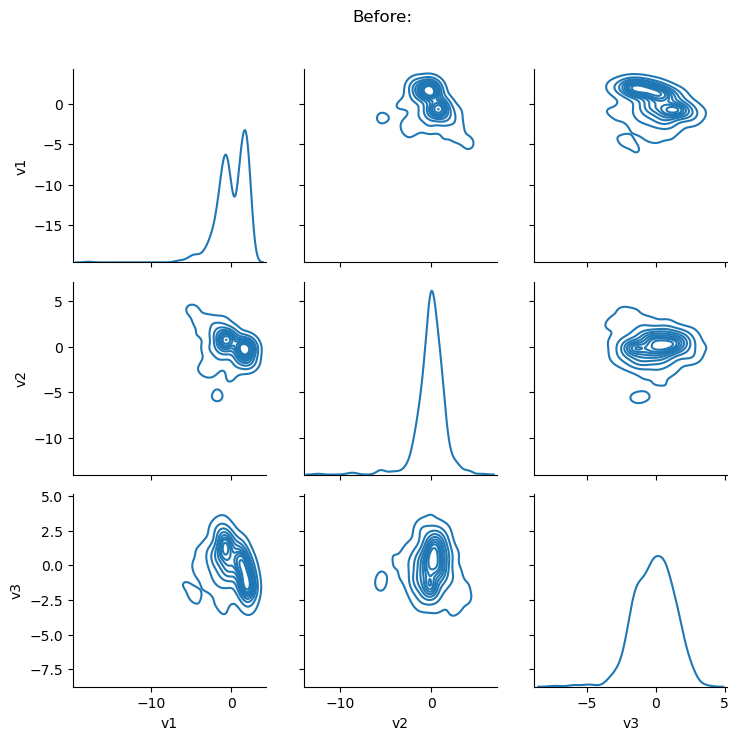

In [18]:
g = sns.PairGrid(X_train.iloc[:,:3].sample(600, random_state=RANDOM_SEED))
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Before:')
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.kdeplot);

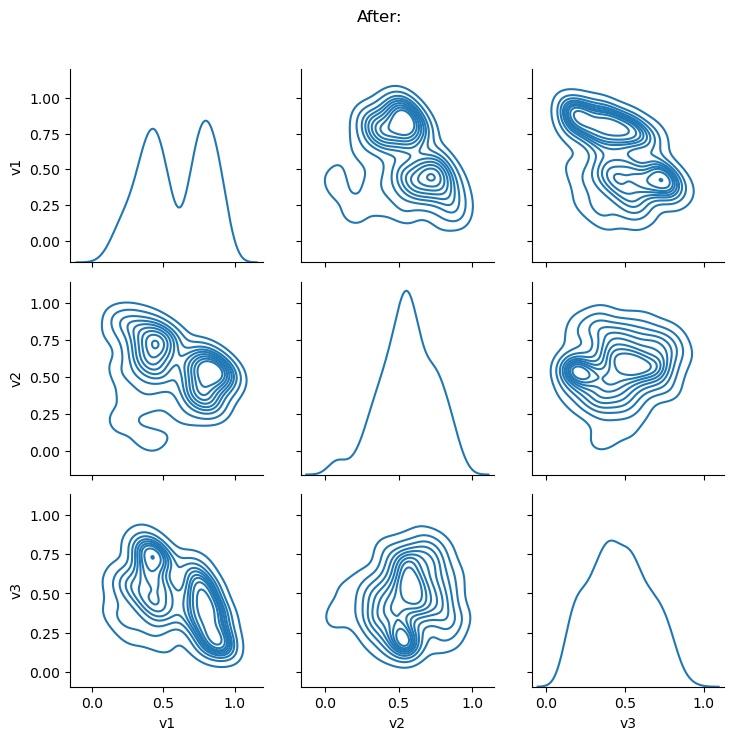

In [19]:
g = sns.PairGrid(pd.DataFrame(X_train_transformed, columns=column_names).iloc[:,:3].sample(600, random_state=RANDOM_SEED))
plt.subplots_adjust(top=0.9)
g.fig.suptitle('After:')
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.kdeplot);

In [20]:
# Load the extension and start TensorBoard
%load_ext tensorboard
%tensorboard --logdir logs

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2023-07-13 19:53:58.331583: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:8893] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-07-13 19:53:58.331605: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-07-13 19:53:58.331619: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-07-13 19:53:58.338590: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appro

In [82]:
# data dimensions // hyperparameters 
input_dim = X_train_transformed.shape[1]
BATCH_SIZE = 64
EPOCHS = 350

# https://keras.io/layers/core/
autoencoder_2 = tf.keras.models.Sequential([
    
    # deconstruct / encode
    tf.keras.layers.Dense(input_dim, activation='elu', input_shape=(input_dim, )), 
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(12, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(6, activation='elu'),
    tf.keras.layers.Dense(4, activation='softplus'),
    #tf.keras.layers.Dense(2, activation='softplus'),
    tf.keras.layers.Dense(2, activation='elu'),
    # reconstruction / decode
    # reconstruction / decode
    tf.keras.layers.Dense(4, activation='softmax'),
    tf.keras.layers.Dense(6, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(12, activation='elu'),
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(input_dim, activation='elu')
    
])

# https://keras.io/api/models/model_training_apis/
autoencoder_2.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])

# print an overview of our model
autoencoder_2.summary();

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_205 (Dense)           (None, 28)                812       
                                                                 
 dense_206 (Dense)           (None, 16)                464       
                                                                 
 dense_207 (Dense)           (None, 12)                204       
                                                                 
 dense_208 (Dense)           (None, 8)                 104       
                                                                 
 dense_209 (Dense)           (None, 6)                 54        
                                                                 
 dense_210 (Dense)           (None, 4)                 28        
                                                                 
 dense_211 (Dense)           (None, 2)               

In [83]:

# current date and time
yyyymmddHHMM = datetime.now().strftime('%Y%m%d%H%M')

# new folder for a new run
log_subdir = f'{yyyymmddHHMM}_batch{BATCH_SIZE}_layers{len(autoencoder.layers)}'

# define our early stopping
early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0.0001,
    patience=10,
    verbose=1, 
    mode='min',
    restore_best_weights=True
)

save_model = tf.keras.callbacks.ModelCheckpoint(
    filepath='autoencoder_best_weights.hdf5',
    save_best_only=True,
    monitor='val_loss',
    verbose=0,
    mode='min'
)

tensorboard = tf.keras.callbacks.TensorBoard(
    f'logs/{log_subdir}',
    batch_size=BATCH_SIZE,
    update_freq='batch'
    #train_log_dir = log_subdir + '/train'
    #test_log_dir = log_subdir + '/test'
    #train_summary_writer = tf.summary.create_file_writer(train_log_dir)
    #test_summary_writer = tf.summary.create_file_writer(test_log_dir)
    #with train_summary_writer.as_default():
    #    tf.summary.scalar('loss', train_loss.result(), step=epoch)
    #    tf.summary.scalar('accuracy', train_accuracy.result(), step=epoch)
)
# callbacks argument only takes a list
cb = [early_stop, save_model, tensorboard]

In [84]:
history = autoencoder_2.fit(
    X_train_transformed, X_train_transformed,
    shuffle=True,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=cb,
    validation_data=(X_validate_transformed, X_validate_transformed)
);

Epoch 1/350


2500/2500 [==============================] - 20s 7ms/step - loss: 0.0197 - acc: 0.2316 - val_loss: 0.0147 - val_acc: 0.3033
Epoch 2/350
  16/2500 [..............................] - ETA: 17s - loss: 0.0145 - acc: 0.2998

/home/alex/.local/lib/python3.11/site-packages/keras/src/engine/training.py:3078: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


2500/2500 [==============================] - 16s 7ms/step - loss: 0.0145 - acc: 0.3097 - val_loss: 0.0143 - val_acc: 0.2954
Epoch 3/350
2500/2500 [==============================] - 15s 6ms/step - loss: 0.0137 - acc: 0.3311 - val_loss: 0.0134 - val_acc: 0.3655
Epoch 4/350
2500/2500 [==============================] - 18s 7ms/step - loss: 0.0131 - acc: 0.3662 - val_loss: 0.0130 - val_acc: 0.3709
Epoch 5/350
2500/2500 [==============================] - 16s 6ms/step - loss: 0.0129 - acc: 0.3749 - val_loss: 0.0129 - val_acc: 0.3659
Epoch 6/350
2500/2500 [==============================] - 16s 6ms/step - loss: 0.0128 - acc: 0.3831 - val_loss: 0.0128 - val_acc: 0.3826
Epoch 7/350
2500/2500 [==============================] - 16s 6ms/step - loss: 0.0126 - acc: 0.3876 - val_loss: 0.0125 - val_acc: 0.3740
Epoch 8/350
2500/2500 [==============================] - 15s 6ms/step - loss: 0.0124 - acc: 0.3867 - val_loss: 0.0123 - val_acc: 0.3823
Epoch 9/350
2500/2500 [==============================] - 16s

In [86]:
# data dimensions // hyperparameters 
input_dim = X_train_transformed.shape[1]
BATCH_SIZE = 64
EPOCHS = 350

# https://keras.io/layers/core/
autoencoder_4 = tf.keras.models.Sequential([
    
    # deconstruct / encode
    tf.keras.layers.Dense(input_dim, activation='elu', input_shape=(input_dim, )), 
    tf.keras.layers.Dense(2, activation='elu'),
    # reconstruction / decode
    tf.keras.layers.Dense(input_dim, activation='elu')
    
])

# https://keras.io/api/models/model_training_apis/
autoencoder_4.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])

# print an overview of our model
autoencoder_4.summary();

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_230 (Dense)           (None, 28)                812       
                                                                 
 dense_231 (Dense)           (None, 2)                 58        
                                                                 
 dense_232 (Dense)           (None, 28)                84        
                                                                 
Total params: 954 (3.73 KB)
Trainable params: 954 (3.73 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [87]:

# current date and time
yyyymmddHHMM = datetime.now().strftime('%Y%m%d%H%M')

# new folder for a new run
log_subdir = f'{yyyymmddHHMM}_batch{BATCH_SIZE}_layers{len(autoencoder.layers)}'

# define our early stopping
early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0.0001,
    patience=10,
    verbose=1, 
    mode='min',
    restore_best_weights=True
)

save_model = tf.keras.callbacks.ModelCheckpoint(
    filepath='autoencoder_best_weights.hdf5',
    save_best_only=True,
    monitor='val_loss',
    verbose=0,
    mode='min'
)

tensorboard = tf.keras.callbacks.TensorBoard(
    f'logs/{log_subdir}',
    batch_size=BATCH_SIZE,
    update_freq='batch'
    #train_log_dir = log_subdir + '/train'
    #test_log_dir = log_subdir + '/test'
    #train_summary_writer = tf.summary.create_file_writer(train_log_dir)
    #test_summary_writer = tf.summary.create_file_writer(test_log_dir)
    #with train_summary_writer.as_default():
    #    tf.summary.scalar('loss', train_loss.result(), step=epoch)
    #    tf.summary.scalar('accuracy', train_accuracy.result(), step=epoch)
)
# callbacks argument only takes a list
cb = [early_stop, save_model, tensorboard]

In [88]:
history = autoencoder_4.fit(
    X_train_transformed, X_train_transformed,
    shuffle=True,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=cb,
    validation_data=(X_validate_transformed, X_validate_transformed)
);

Epoch 1/350


2500/2500 [==============================] - 11s 4ms/step - loss: 0.0261 - acc: 0.0468 - val_loss: 0.0163 - val_acc: 0.0830
Epoch 2/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0155 - acc: 0.2494 - val_loss: 0.0150 - val_acc: 0.3146
Epoch 3/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0148 - acc: 0.3126 - val_loss: 0.0147 - val_acc: 0.3072
Epoch 4/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0146 - acc: 0.3116 - val_loss: 0.0146 - val_acc: 0.3065
Epoch 5/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0145 - acc: 0.3131 - val_loss: 0.0145 - val_acc: 0.3061
Epoch 6/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0145 - acc: 0.3138 - val_loss: 0.0145 - val_acc: 0.3100
Epoch 7/350
2500/2500 [==============================] - 10s 4ms/step - loss: 0.0145 - acc: 0.3147 - val_loss: 0.0145 - val_acc: 0.3061
Epoch 8/350
2500/2500 [==============================] - 10s

In [90]:
# data dimensions // hyperparameters 
input_dim = X_train_transformed.shape[1]
BATCH_SIZE = 16
EPOCHS = 350

# https://keras.io/layers/core/
autoencoder_22 = tf.keras.models.Sequential([
    
    # deconstruct / encode
    tf.keras.layers.Dense(input_dim, activation='elu', input_shape=(input_dim, )), 
    tf.keras.layers.Dense(2, activation='elu'),
    # reconstruction / decode
    tf.keras.layers.Dense(input_dim, activation='elu')
    
])

# https://keras.io/api/models/model_training_apis/
autoencoder_22.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])

# print an overview of our model
autoencoder_22.summary();

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_245 (Dense)           (None, 28)                812       
                                                                 
 dense_246 (Dense)           (None, 2)                 58        
                                                                 
 dense_247 (Dense)           (None, 28)                84        
                                                                 
Total params: 954 (3.73 KB)
Trainable params: 954 (3.73 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [91]:

# current date and time
yyyymmddHHMM = datetime.now().strftime('%Y%m%d%H%M')

# new folder for a new run
log_subdir = f'{yyyymmddHHMM}_batch{BATCH_SIZE}_layers{len(autoencoder.layers)}'

# define our early stopping
early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0.0001,
    patience=10,
    verbose=1, 
    mode='min',
    restore_best_weights=True
)

save_model = tf.keras.callbacks.ModelCheckpoint(
    filepath='autoencoder_best_weights.hdf5',
    save_best_only=True,
    monitor='val_loss',
    verbose=0,
    mode='min'
)

tensorboard = tf.keras.callbacks.TensorBoard(
    f'logs/{log_subdir}',
    batch_size=BATCH_SIZE,
    update_freq='batch'
    #train_log_dir = log_subdir + '/train'
    #test_log_dir = log_subdir + '/test'
    #train_summary_writer = tf.summary.create_file_writer(train_log_dir)
    #test_summary_writer = tf.summary.create_file_writer(test_log_dir)
    #with train_summary_writer.as_default():
    #    tf.summary.scalar('loss', train_loss.result(), step=epoch)
    #    tf.summary.scalar('accuracy', train_accuracy.result(), step=epoch)
)
# callbacks argument only takes a list
cb = [early_stop, save_model, tensorboard]

In [92]:
history = autoencoder_22.fit(
    X_train_transformed, X_train_transformed,
    shuffle=True,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=cb,
    validation_data=(X_validate_transformed, X_validate_transformed)
);

Epoch 1/350
10000/10000 [==============================] - 43s 4ms/step - loss: 0.0188 - acc: 0.2094 - val_loss: 0.0148 - val_acc: 0.3066
Epoch 2/350
   40/10000 [..............................] - ETA: 39s - loss: 0.0148 - acc: 0.2984

/home/alex/.local/lib/python3.11/site-packages/keras/src/engine/training.py:3078: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


10000/10000 [==============================] - 44s 4ms/step - loss: 0.0146 - acc: 0.3133 - val_loss: 0.0145 - val_acc: 0.3089
Epoch 3/350
10000/10000 [==============================] - 43s 4ms/step - loss: 0.0145 - acc: 0.3187 - val_loss: 0.0145 - val_acc: 0.3179
Epoch 4/350
10000/10000 [==============================] - 47s 5ms/step - loss: 0.0145 - acc: 0.3246 - val_loss: 0.0145 - val_acc: 0.3201
Epoch 5/350
10000/10000 [==============================] - 46s 5ms/step - loss: 0.0144 - acc: 0.3296 - val_loss: 0.0144 - val_acc: 0.3329
Epoch 6/350
10000/10000 [==============================] - 45s 4ms/step - loss: 0.0144 - acc: 0.3384 - val_loss: 0.0144 - val_acc: 0.3382
Epoch 7/350
10000/10000 [==============================] - 47s 5ms/step - loss: 0.0144 - acc: 0.3468 - val_loss: 0.0144 - val_acc: 0.3449
Epoch 8/350
10000/10000 [==============================] - 45s 5ms/step - loss: 0.0144 - acc: 0.3500 - val_loss: 0.0144 - val_acc: 0.3450
Epoch 9/350
10000/10000 [=====================

In [93]:
# data dimensions // hyperparameters 
input_dim = X_train_transformed.shape[1]
BATCH_SIZE = 64
EPOCHS = 350

# https://keras.io/layers/core/
encoder = tf.keras.models.Sequential([
    
    # deconstruct / encode
    tf.keras.layers.Dense(input_dim, activation='elu', input_shape=(input_dim, )), 
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(12, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(6, activation='elu'),
    tf.keras.layers.Dense(5, activation='softplus'),
    #tf.keras.layers.Dense(2, activation='softplus'),
    

    
])
decoder = tf.keras.models.Sequential([
        
    # reconstruction / decode
    tf.keras.layers.Dense(5, activation='softmax'),
    tf.keras.layers.Dense(6, activation='elu'),
    tf.keras.layers.Dense(8, activation='elu'),
    tf.keras.layers.Dense(12, activation='elu'),
    tf.keras.layers.Dense(16, activation='elu'),
    tf.keras.layers.Dense(input_dim, activation='elu')
    
])

# https://keras.io/api/models/model_training_apis/
encoder.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])
encoder.summary();
decoder.compile(optimizer="adam", 
                    loss="mse",
                    metrics=["acc"])
decoder.summary();

# print an overview of our model
autoencoder.summary();

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_248 (Dense)           (None, 28)                812       
                                                                 
 dense_249 (Dense)           (None, 16)                464       
                                                                 
 dense_250 (Dense)           (None, 12)                204       
                                                                 
 dense_251 (Dense)           (None, 8)                 104       
                                                                 
 dense_252 (Dense)           (None, 6)                 54        
                                                                 
 dense_253 (Dense)           (None, 5)                 35        
                                                                 
Total params: 1673 (6.54 KB)
Trainable params: 1673 (

ValueError: This model has not yet been built. Build the model first by calling `build()` or by calling the model on a batch of data.

# Classificative Adversarial Network